In [1]:
%load_ext autoreload
%autoreload 2

In [23]:
import sys, os
sys.path.append("../..")
sys.path.append("..")
sys.path.append(os.getcwd())
import re
import datetime

import math
import scipy

from matplotlib import pyplot as plt
import matplotlib.ticker as ticker
import matplotlib.dates as mdates
import seaborn as sns
sns.set()
sns.set(palette="bright")
sns.set_style("whitegrid")

from sklearn import linear_model
from cycler import cycler
from celluloid import Camera
from IPython.display import HTML

import importlib
import warnings
import numpy as np
import pandas as pd
import copy
import random
from tslib.src import tsUtils
from tslib.tests import testdata
from sklearn.cluster import KMeans, AgglomerativeClustering, AffinityPropagation, DBSCAN #For clustering
from sklearn.mixture import GaussianMixture #For GMM clustering
from filter_data import *
from load_and_clean import *
import hdbscan
import plotly.figure_factory as ff
%matplotlib inline

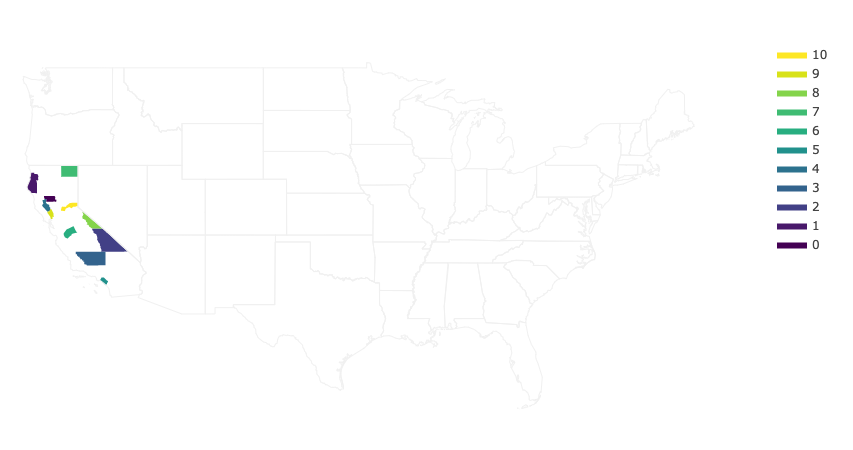

In [1]:
import plotly.figure_factory as ff

fips = ['06021', '06023', '06027',
        '06029', '06033', '06059',
        '06047', '06049', '06051',
        '06055', '06061']
values = range(len(fips))

fig = ff.create_choropleth(fips=fips, values=values)
fig.layout.template = None
fig.show()pip3 

In [4]:
temp_data, fips = load_clean('temperature')
post_memo = temp_data.loc['2020-07-04':]

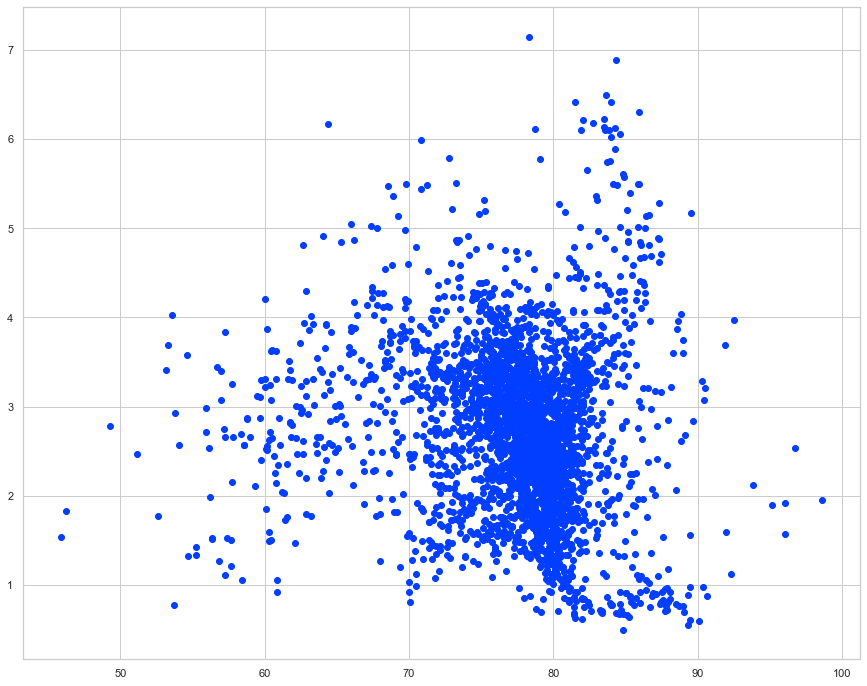

In [5]:
plt.figure(figsize = (15, 12))
plt.scatter(post_memo.mean(), post_memo.std())
plt.show()

## HDBSCAN

In [6]:
feature_dict, features = cluster_temperature(post_memo)

{-1: Index(['Ada-Idaho', 'Adams-Colorado', 'Adams-Idaho', 'Adams-Washington',
        'Alameda-California', 'Alamosa-Colorado', 'Albany-Wyoming',
        'Alger-Michigan', 'Alpine-California', 'Amador-California',
        ...
        'Weston-Wyoming', 'Whatcom-Washington', 'Whitman-Washington',
        'Winnebago-Wisconsin', 'Yakima-Washington', 'Yellowstone-Montana',
        'Yolo-California', 'York-Maine', 'York-Pennsylvania', 'Yuma-Arizona'],
       dtype='object', name='county_state', length=355),
 0: Index(['Benton-Oregon', 'Clackamas-Oregon', 'Clark-Washington',
        'Clatsop-Oregon', 'Columbia-Oregon', 'Coos-Oregon',
        'Cowlitz-Washington', 'Douglas-Oregon', 'Grays Harbor-Washington',
        'Humboldt-California', 'King-Washington', 'Lane-Oregon',
        'Lewis-Washington', 'Lincoln-Oregon', 'Linn-Oregon', 'Marin-California',
        'Marion-Oregon', 'Mason-Washington', 'Pacific-Washington',
        'Pierce-Washington', 'Polk-Oregon', 'Skagit-Washington',
        'Ska

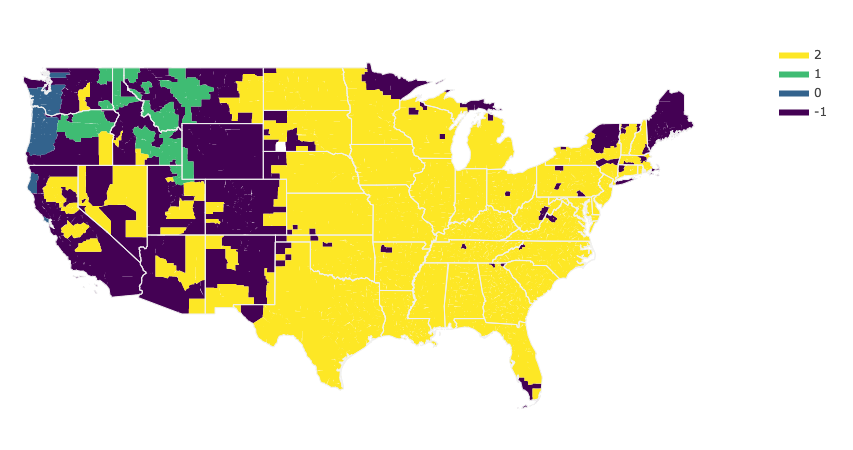

In [38]:
df = pd.DataFrame.drop_duplicates(pd.merge(features['DB'].reset_index(), fips, 
                              how = 'right', on = ['county_state']))
group = df['county_fips_code']
values = df['DB']
fig = ff.create_choropleth(fips=group, values=values)
fig.layout.template = None
fig.show()

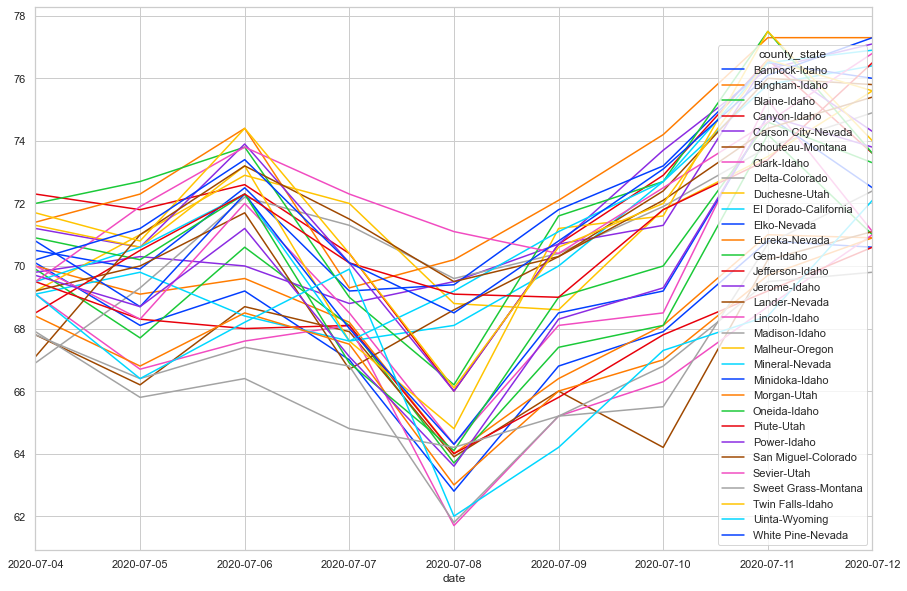

In [42]:
post_memo[feature_dict[1]].plot(figsize = (15, 10))

## K-means

In [39]:
#k-means
feature_dict, features = cluster_temperature(post_memo, cluster_method = 'kmeans')

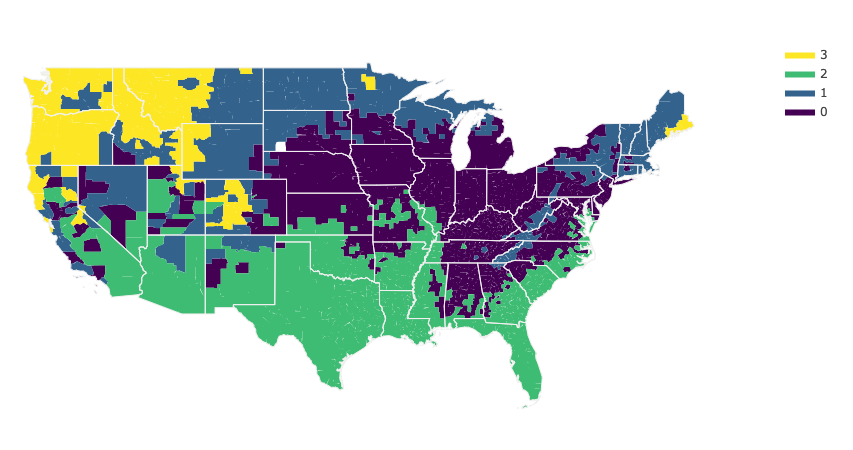

In [42]:
df = pd.DataFrame.drop_duplicates(pd.merge(features['kmeans'].reset_index(), fips, 
                              how = 'right', on = ['county_state']))
group = df['county_fips_code']
values = df['kmeans']
fig = ff.create_choropleth(fips=group, values=values)
fig.layout.template = None
fig.show()

## AgglomerativeClustering

In [43]:
feature_dict, features = cluster_temperature(post_memo, cluster_method = 'AgglomerativeClustering')

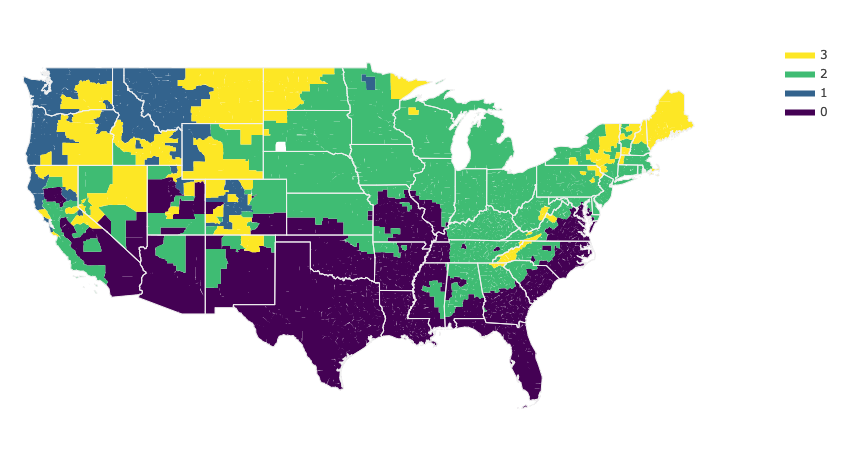

In [44]:
df = pd.DataFrame.drop_duplicates(pd.merge(features['AC'].reset_index(), fips, 
                              how = 'right', on = ['county_state']))
group = df['county_fips_code']
values = df['AC']
fig = ff.create_choropleth(fips=group, values=values)
fig.layout.template = None
fig.show()